In [1]:
# HIDE CODE


import re
import os
import sys
import numpy as np
import pandas as pd
import nibabel as nib
from pathlib import Path
from os.path import join as pjoin
from scipy import stats as sp_stats
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style('whitegrid')


# GitHub
git_path = pjoin(os.environ['HOME'], 'Dropbox/git/Ca-fMRI/')
sys.path.insert(0, git_path)
from simulation.simulation import *
from utils.plotting import *
from utils.processing import *
from model.configuration import Config

In [2]:
config = Config()
vars(config)

{'base_dir': '/home/hadi/Documents/Ca-fMRI',
 'run_duration': 600,
 'exclude': 50,
 'ca_fs': 10,
 'bold_fs': 1,
 'num_subjects': 10,
 'num_sessions': 3,
 'num_runs': 7,
 'ws_dir': '/home/hadi/Documents/Ca-fMRI',
 'processed_dir': '/home/hadi/Documents/Ca-fMRI/processed',
 'download_dir': '/mnt/storage/hadi/Ca-fMRI',
 'raw_dir': '/mnt/storage/hadi/Ca-fMRI/raw',
 'npy_dir': '/mnt/storage/hadi/Ca-fMRI/npy',
 'labels': {1: 'R-Frontal pole, cerebral cortex (FRP,184)',
  2: 'R-Primary motor area (MOp,985)',
  3: 'R-Secondary motor area (MOs,993)',
  4: 'R-Primary somatosensory area, nose (SSp-n,353)',
  5: 'R-Primary somatosensory area, barrel field (SSp-bfd,329)',
  6: 'R-Primary somatosensory area, lower limb (SSp-ll,337)',
  7: 'R-Primary somatosensory area, mouth (SSp-m,345)',
  8: 'R-Primary somatosensory area, upper limb (SSp-ul,369)',
  9: 'R-Primary somatosensory area, trunk (SSp-tr,361)',
  10: 'R-Primary somatosensory area, unassigned (SSp-un,182305689)',
  11: 'R-Supplemental soma

In [3]:
# import warnings
# warnings.filterwarnings('ignore', category=RuntimeWarning)

In [4]:
organize_ca_data(
    config=config,
    lowcut=0.001,
    highcut=2.0,
    bandpass_order=2,
    bandpass=True,
    normalize=True,
    verbose=False,
)

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

Warning! File not found, moving on . . .
['sub-SLC03', 'ses-1', 'run-1', 'ca']



  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

Warning! File not found, moving on . . .
['sub-SLC05', 'ses-1', 'run-5', 'ca']



  0%|          | 0/3 [00:00<?, ?it/s]

Warning! File not found, moving on . . .
['sub-SLC06', 'ses-3', 'run-2', 'ca']



  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

Warning! File not found, moving on . . .
['sub-SLC08', 'ses-1', 'run-7', 'ca']



  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

Warning! File not found, moving on . . .
['sub-SLC10', 'ses-3', 'run-1', 'ca']



In [5]:
organize_ca_data(
    config=config,
    lowcut=0.001,
    highcut=4.0,
    bandpass_order=2,
    bandpass=True,
    normalize=False,
    verbose=False,
)

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

Warning! File not found, moving on . . .
['sub-SLC03', 'ses-1', 'run-1', 'ca']



  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

Warning! File not found, moving on . . .
['sub-SLC05', 'ses-1', 'run-5', 'ca']



  0%|          | 0/3 [00:00<?, ?it/s]

Warning! File not found, moving on . . .
['sub-SLC06', 'ses-3', 'run-2', 'ca']



  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

Warning! File not found, moving on . . .
['sub-SLC08', 'ses-1', 'run-7', 'ca']



  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

Warning! File not found, moving on . . .
['sub-SLC10', 'ses-3', 'run-1', 'ca']



In [8]:
sorted(os.listdir(pjoin(config.processed_dir, 'filtered_low-0.002_high-1.000_ord-2_normalized')))

['sub-SLC01_ses-1_run-1_task-rest_ca_organized.npy',
 'sub-SLC01_ses-1_run-2_task-led_ca_organized.npy',
 'sub-SLC01_ses-1_run-3_task-rest_ca_organized.npy',
 'sub-SLC01_ses-1_run-4_task-led_ca_organized.npy',
 'sub-SLC01_ses-1_run-5_task-rest_ca_organized.npy',
 'sub-SLC01_ses-1_run-6_task-led_ca_organized.npy',
 'sub-SLC01_ses-1_run-7_task-rest_ca_organized.npy',
 'sub-SLC01_ses-2_run-1_task-rest_ca_organized.npy',
 'sub-SLC01_ses-2_run-2_task-led_ca_organized.npy',
 'sub-SLC01_ses-2_run-3_task-rest_ca_organized.npy',
 'sub-SLC01_ses-2_run-4_task-led_ca_organized.npy',
 'sub-SLC01_ses-2_run-5_task-rest_ca_organized.npy',
 'sub-SLC01_ses-2_run-6_task-led_ca_organized.npy',
 'sub-SLC01_ses-2_run-7_task-rest_ca_organized.npy',
 'sub-SLC01_ses-3_run-1_task-rest_ca_organized.npy',
 'sub-SLC01_ses-3_run-2_task-led_ca_organized.npy',
 'sub-SLC01_ses-3_run-3_task-rest_ca_organized.npy',
 'sub-SLC01_ses-3_run-4_task-led_ca_organized.npy',
 'sub-SLC01_ses-3_run-5_task-rest_ca_organized.npy',
 

In [43]:
load = load_organized_data(
    folder='filtered_low-0.002_high-1.000_ord-2_normalized',
    subject=1,
    session=1,
    run=1,
)

In [44]:
load.keys()

dict_keys(['ca', 'atlas', 'ref', 'mask'])

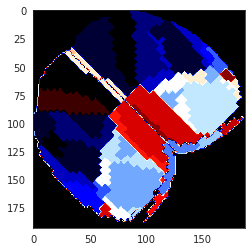

In [45]:
plt.imshow(load['atlas'], cmap='flag_r')

In [50]:
set(np.unique(load['atlas'])).difference(set(load['ca'].keys()))

{0, 222, 722}

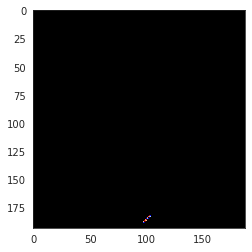

In [54]:
plt.imshow(load['atlas'] == 722, cmap='flag_r')

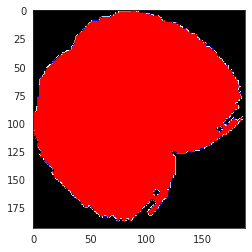

In [55]:
plt.imshow((load['atlas'] != 722) & (load['atlas'] > 0), cmap='flag_r')

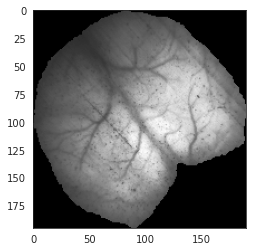

In [12]:
plt.imshow(load['ref'], cmap='Greys_r')

In [13]:
len(load['ca'])

61

In [14]:
x = np.zeros(load['atlas'].shape + (list(load['ca'].values())[0].shape[-1],))

for key, data in load['ca'].items():
    
    num_nan = np.isnan(load['ca'][key]).mean().sum()
    if num_nan > 0:
        print(key, num_nan)
        continue
    
    x[load['atlas'] == key] = load['ca'][key]

x.shape

(195, 191, 5500)

In [17]:
load['ca'].keys(), len(load['ca'])

(dict_keys([2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 16, 18, 19, 20, 21, 22, 23, 24, 25, 26, 28, 30, 38, 39, 40, 154, 155, 156, 221, 502, 503, 504, 505, 506, 507, 508, 509, 510, 511, 514, 515, 516, 518, 519, 520, 521, 522, 523, 524, 525, 526, 528, 530, 538, 539, 540, 541, 655, 656]),
 61)

In [18]:
len(np.unique(load['atlas']))

64

{0, 222, 722}

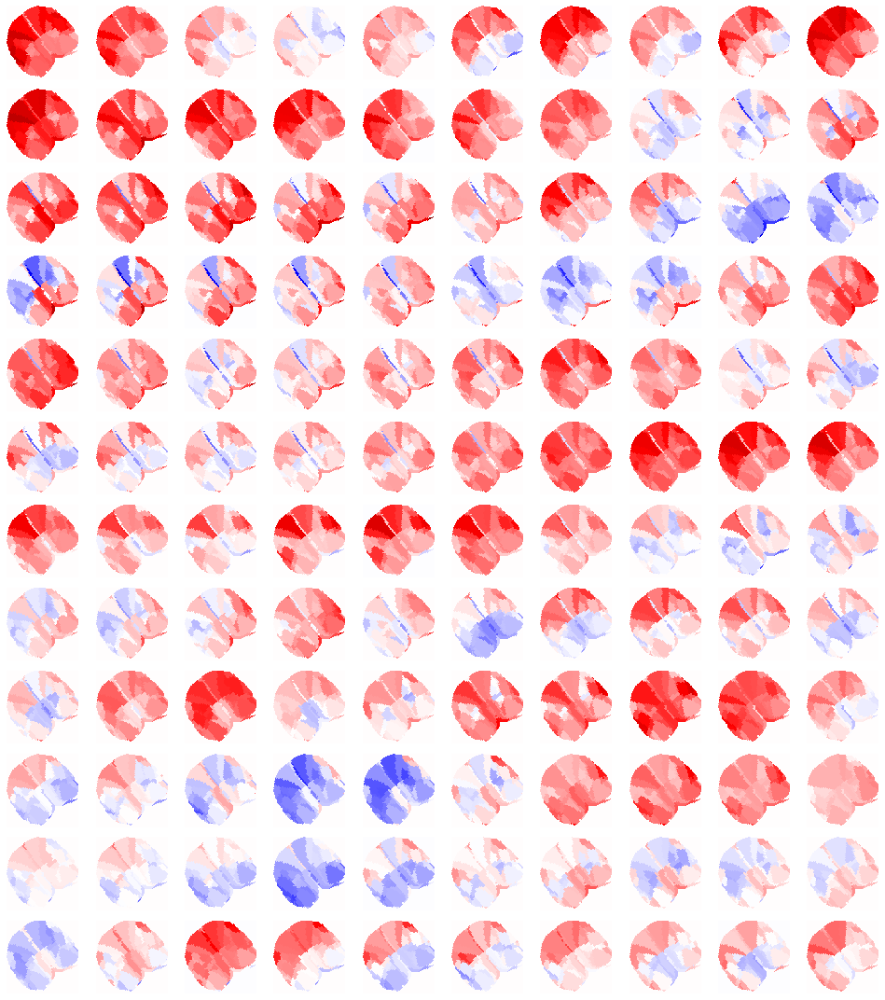

In [19]:
t = 1800
res = 10

_slice = x[..., t: t + res * 120]
vminmax = np.max(np.abs(_slice))

sns.set_style('white')
nrows, ncols = 12, 10
fig, axes = plt.subplots(nrows, ncols, figsize=(13.5, 15))

for idx in range(_slice.shape[-1] // res):
    i, j = idx//ncols, idx%ncols
    axes[i, j].imshow(_slice[..., idx * res], vmin=-vminmax, vmax=vminmax, cmap='seismic', interpolation='none')
    axes[i, j].axis('off')
    
fig.tight_layout()

In [20]:
file = pjoin(
    config.processed_dir,
    'unfiltered_normalized',
    'sub-SLC06_ses-1_run-3_task-rest_ca_organized.npy',
)

load = np.load(file, allow_pickle=True).item()

In [21]:
load.keys()

dict_keys(['ca', 'atlas', 'ref', 'mask'])

In [24]:
len(load['ca'])

61

In [25]:
x = np.zeros(load['atlas'].shape + (list(load['ca'].values())[0].shape[-1],))

for key, data in load['ca'].items():
    
    num_nan = np.isnan(load['ca'][key]).mean().sum()
    if num_nan > 0:
        print(key, num_nan)
        continue
    
    x[load['atlas'] == key] = load['ca'][key]

x.shape

(195, 191, 5500)

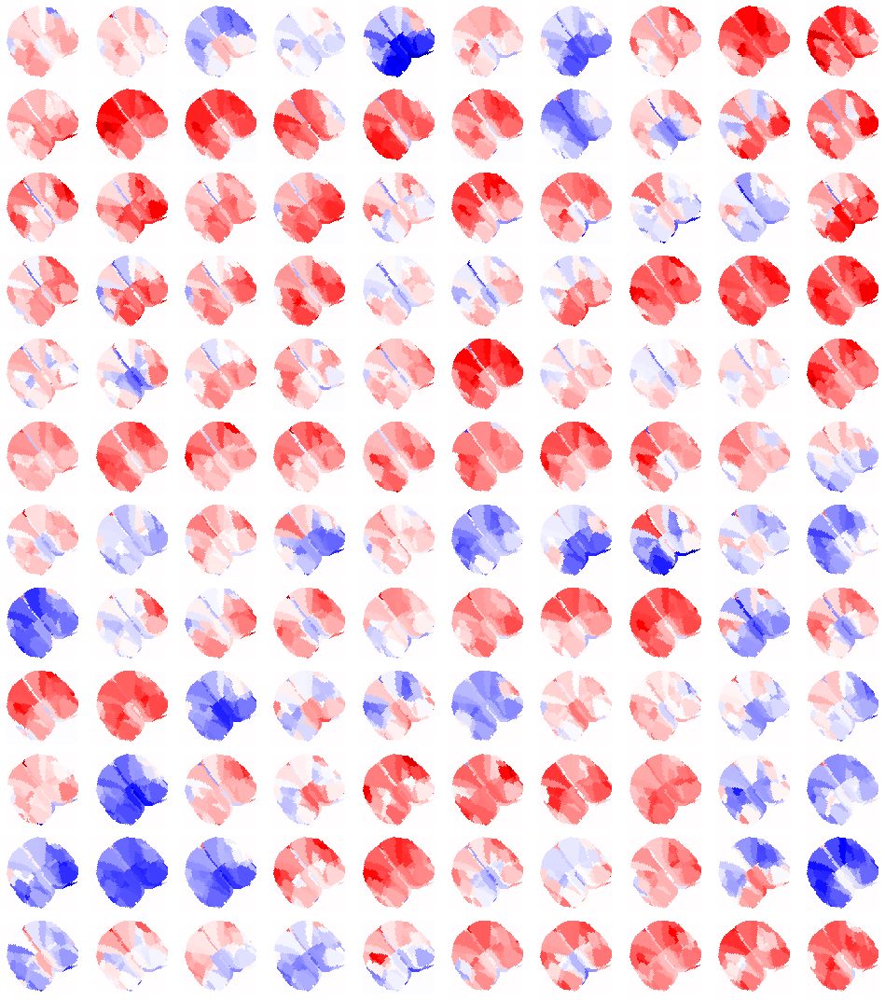

In [26]:
t = 1800
res = 10

_slice = x[..., t: t + res * 120]
vminmax = np.max(np.abs(_slice))

sns.set_style('white')
nrows, ncols = 12, 10
fig, axes = plt.subplots(nrows, ncols, figsize=(13.5, 15))

for idx in range(_slice.shape[-1] // res):
    i, j = idx//ncols, idx%ncols
    axes[i, j].imshow(_slice[..., idx * res], vmin=-vminmax, vmax=vminmax, cmap='seismic', interpolation='none')
    axes[i, j].axis('off')
    
fig.tight_layout()
plt.show()

In [28]:
data = load_ca_with_extras(config, 6, 1, 3)

Loading:
sub-SLC06_ses-1_run-3_task-rest_ca.npy

-->  50 s  <-- excluded from the beginning of each run. Combined runs duration:
00 - 00:09:10  (dd - hh:mm:ss)



In [29]:
data.keys()

dict_keys(['ca', 'atlas', 'ref', 'mask', 'file_name'])

In [30]:
data['ca'].shape

(256, 250, 5500)

In [31]:
data['ca']

array([[[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.]],

       [[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.]],

       [[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.]],

       ...,

       [[0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        ...,
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0., 0.],
        [0., 0., 0., ..., 0., 0.

In [36]:
test = sp_stats.zscore(data['ca'])

In [37]:
test_slice = test[..., t: t + res * 120]

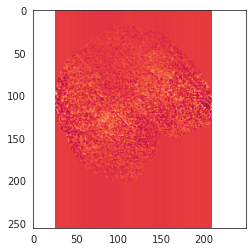

In [38]:
plt.imshow(test_slice[..., 10])

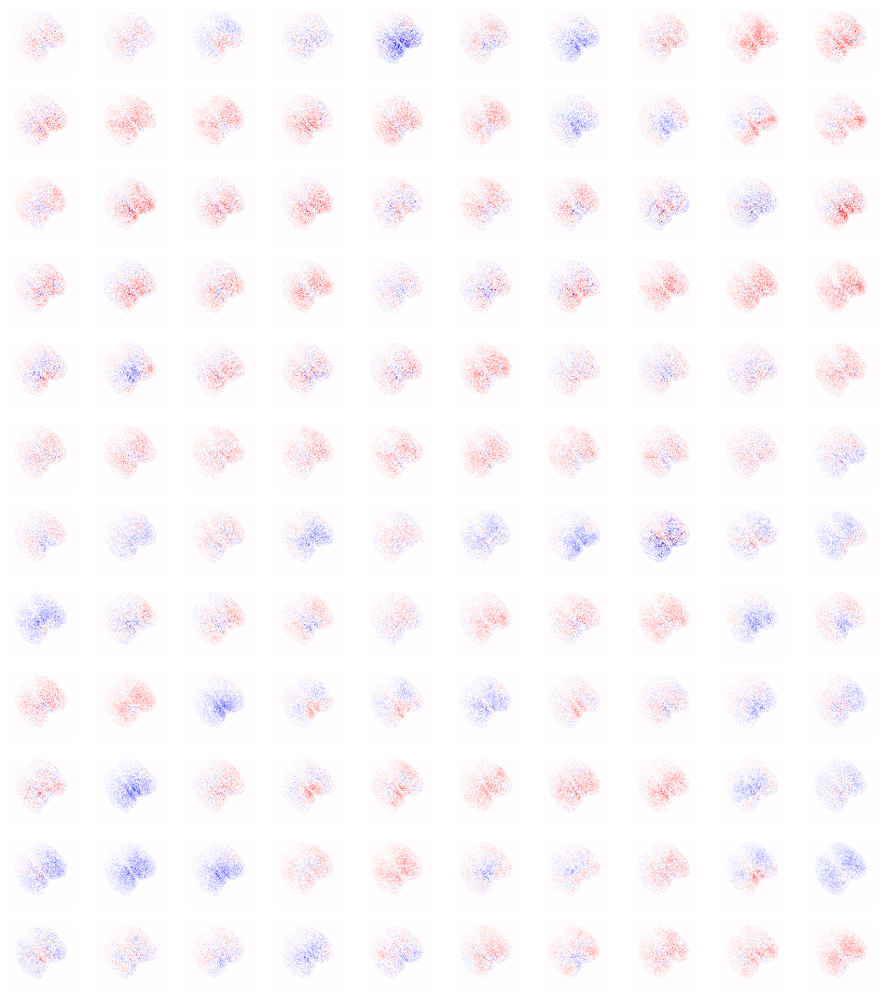

In [39]:
_slice = data['ca'][..., t: t + res * 120]
vminmax = np.max(np.abs(_slice))

sns.set_style('white')
nrows, ncols = 12, 10
fig, axes = plt.subplots(nrows, ncols, figsize=(13.5, 15))

for idx in range(_slice.shape[-1] // res):
    i, j = idx//ncols, idx%ncols
    axes[i, j].imshow(_slice[..., idx * res], vmin=-vminmax, vmax=vminmax, cmap='seismic', interpolation='none')
    axes[i, j].axis('off')
    
fig.tight_layout()
plt.show()

### OLD
---

In [6]:
run_duration = 600
ca_fs = 10
exclude = 50

data = {}
for run in [1, 3, 5, 7]:
    data[run] = load_ca_data(
        config=config,
        keywords=['ca', 'ses-1', 'sub-SLC06', 'rest', 'run-{:d}'.format(run)],
        ca_fs=ca_fs,
        run_duration=run_duration,
        exclude=exclude,
        verbose=True,
    )

Data from 1 runs loaded:

['sub-SLC06_ses-1_run-1_task-rest_ca.npy']

-->  50 s  <-- excluded from the beginning of each run. Combined runs duration:

00 - 00:09:10  (dd - hh:mm:ss)

Data from 1 runs loaded:

['sub-SLC06_ses-1_run-3_task-rest_ca.npy']

-->  50 s  <-- excluded from the beginning of each run. Combined runs duration:

00 - 00:09:10  (dd - hh:mm:ss)

Data from 1 runs loaded:

['sub-SLC06_ses-1_run-5_task-rest_ca.npy']

-->  50 s  <-- excluded from the beginning of each run. Combined runs duration:

00 - 00:09:10  (dd - hh:mm:ss)

Data from 1 runs loaded:

['sub-SLC06_ses-1_run-7_task-rest_ca.npy']

-->  50 s  <-- excluded from the beginning of each run. Combined runs duration:

00 - 00:09:10  (dd - hh:mm:ss)



In [7]:
ca_combined = np.concatenate(list(data.values()), axis=-1)
mean_global = ca_combined.mean(-1)
sd_global = ca_combined.std(-1)

In [8]:
dict_list = []
for run, ca in data.items():
    npix_x, npix_y, _ = ca.shape
    mean = ca.mean(-1)
    sd = ca.std(-1)

    for i in range(npix_x):
        for j in range(npix_y):
            if mean_global[i, j] == 0:
                continue
            
            delta_mean = (mean[i, j] - mean_global[i, j])
            delta_sd = (sd[i, j] - sd_global[i, j])
            
            data_dict = {
                'run': [run],
                'delta_mean': [delta_mean],
                'delta_sd': [delta_sd],
                'i': [i],
                'j': [j],
            }
            dict_list.append(data_dict)
            
df = pd.DataFrame.from_dict(merge_dicts(dict_list))

In [9]:
df

,run,delta_mean,delta_sd,i,j
0,1,4.489158,0.830264,0,77
1,1,4.507470,0.587190,0,78
2,1,4.563443,2.122081,0,79
3,1,4.703911,0.967884,0,80
4,1,4.641875,0.246834,0,81
...,...,...,...,...,...
94931,7,-0.811409,-4.090026,188,88
94932,7,-0.925899,-3.215286,188,89
94933,7,-1.002897,-2.169539,189,86
94934,7,-0.634345,-1.152023,189,87


In [10]:
palette = sns.color_palette('Dark2', n_colors=4)
palette

[(0.10588235294117647, 0.6196078431372549, 0.4666666666666667),
 (0.8509803921568627, 0.37254901960784315, 0.00784313725490196),
 (0.4588235294117647, 0.4392156862745098, 0.7019607843137254),
 (0.9058823529411765, 0.1607843137254902, 0.5411764705882353)]

<AxesSubplot:xlabel='j', ylabel='delta_mean'>

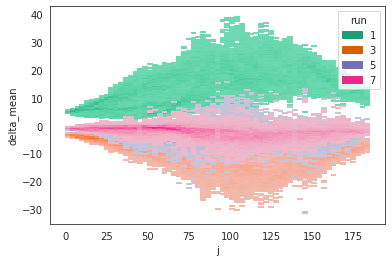

In [11]:
sns.histplot(data=df, x='j', y='delta_mean', hue='run', palette=palette)

<AxesSubplot:xlabel='j', ylabel='delta_sd'>

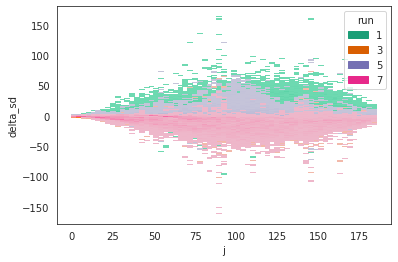

In [12]:
sns.histplot(data=df, x='j', y='delta_sd', hue='run', palette=palette)

<AxesSubplot:xlabel='delta_sd', ylabel='Count'>

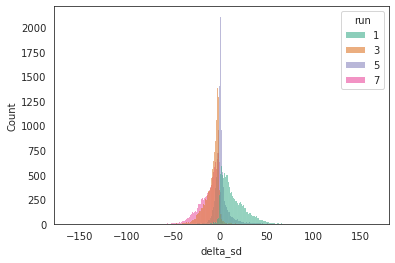

In [13]:
sns.histplot(data=df, x='delta_sd', hue='run', palette=palette)

<AxesSubplot:xlabel='delta_mean', ylabel='Count'>

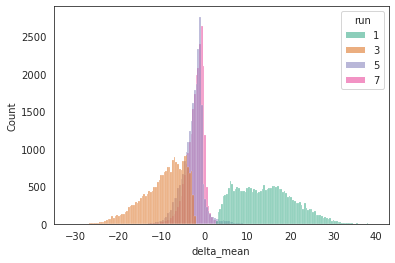

In [14]:
sns.histplot(data=df, x='delta_mean', hue='run', palette=palette)

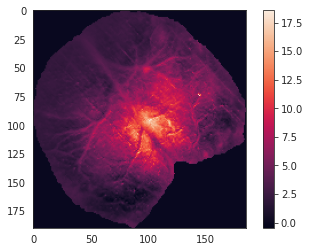

In [15]:
plt.imshow(mean_global)
plt.colorbar()

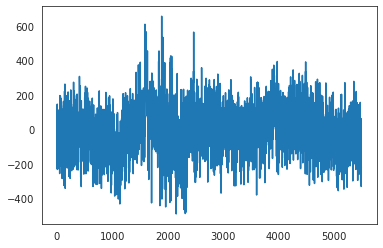

In [16]:
plt.plot(data[3][129, 56])

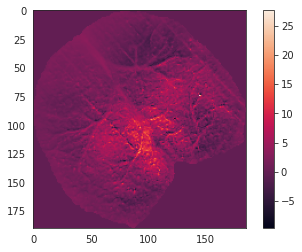

In [17]:
plt.imshow(data[7].mean(-1))
plt.colorbar()

In [3]:
config.labels

{1: 'R-Frontal pole, cerebral cortex (FRP,184)',
 2: 'R-Primary motor area (MOp,985)',
 3: 'R-Secondary motor area (MOs,993)',
 4: 'R-Primary somatosensory area, nose (SSp-n,353)',
 5: 'R-Primary somatosensory area, barrel field (SSp-bfd,329)',
 6: 'R-Primary somatosensory area, lower limb (SSp-ll,337)',
 7: 'R-Primary somatosensory area, mouth (SSp-m,345)',
 8: 'R-Primary somatosensory area, upper limb (SSp-ul,369)',
 9: 'R-Primary somatosensory area, trunk (SSp-tr,361)',
 10: 'R-Primary somatosensory area, unassigned (SSp-un,182305689)',
 11: 'R-Supplemental somatosensory area (SSs,378)',
 12: 'R-Gustatory areas (GU,1057)',
 13: 'R-Visceral area (VISC,677)',
 14: 'R-Dorsal auditory area (AUDd,1011)',
 15: 'R-Primary auditory area (AUDp,1002)',
 16: 'R-Posterior auditory area (AUDpo,1027)',
 17: 'R-Ventral auditory area (AUDv,1018)',
 18: 'R-Anterolateral visual area (VISal,402)',
 19: 'R-Anteromedial visual area (VISam,394)',
 20: 'R-Lateral visual area (VISl,409)',
 21: 'R-Primary v

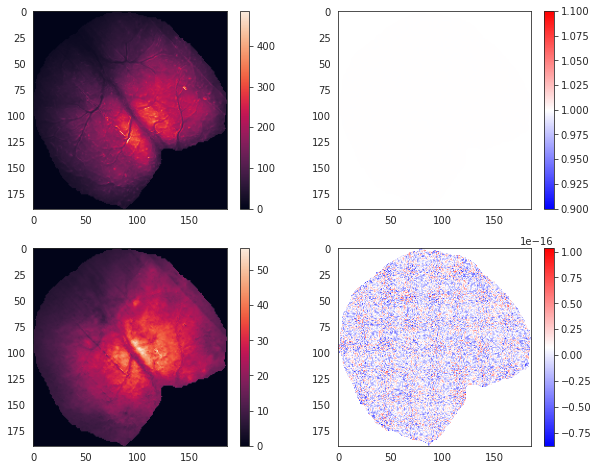

In [27]:
plt.figure(figsize=(10, 8))


plt.subplot(221)
plt.imshow(data[1].std(-1))
plt.colorbar()

plt.subplot(222)
plt.imshow(normalized_data[1].std(-1), cmap='bwr')
plt.colorbar()

plt.subplot(223)
plt.imshow(data[1].mean(-1))
plt.colorbar()

plt.subplot(224)
plt.imshow(normalized_data[1].mean(-1), cmap='bwr')
plt.colorbar()

In [20]:
data[1].std(-1)

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

In [21]:
normalized_data = {run: sp_stats.zscore(ca, axis=-1) for run, ca in data.items()}

/home/hadi/anaconda3/lib/python3.8/site-packages/scipy/stats/stats.py:2500: RuntimeWarning: invalid value encountered in true_divide
  return (a - mns) / sstd


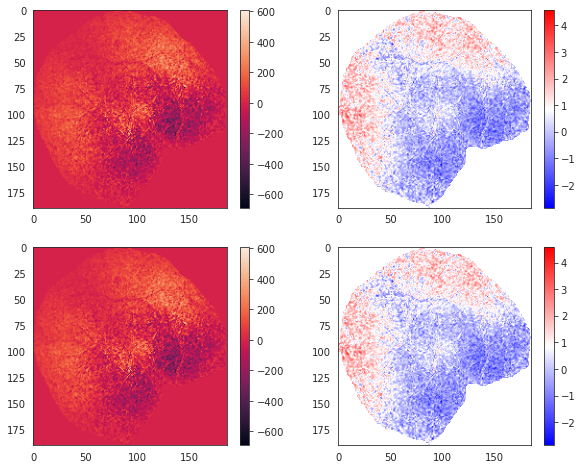

In [46]:
plt.figure(figsize=(10, 8))

t = 1713

plt.subplot(221)
plt.imshow(data[1][..., t])
plt.colorbar()

plt.subplot(222)
plt.imshow(normalized_data[1][..., t], cmap='bwr')
plt.colorbar()

plt.subplot(223)
plt.imshow(data[1][..., t])
plt.colorbar()

plt.subplot(224)
plt.imshow(normalized_data[1][..., t], cmap='bwr')
plt.colorbar()

In [47]:
normalized_data[1][..., t]

array([[nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       ...,
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan]])

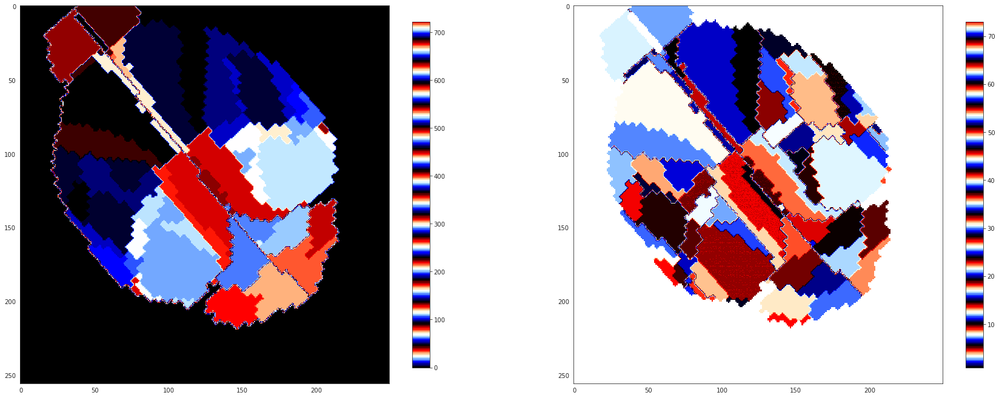

In [74]:
plt.figure(figsize=(30, 15))

plt.subplot(121)
plt.imshow(a[..., 0], cmap='flag_r')
plt.colorbar(shrink=0.7)

plt.subplot(122)
plt.imshow(b, cmap='flag_r')
plt.colorbar(shrink=0.7)
plt.show()

In [4]:
ca, atlas = load_ca_with_atlas()

Loading:
sub-SLC06_ses-1_run-1_task-rest_ca.npy

-->  50 s  <-- excluded from the beginning of each run. Combined runs duration:
00 - 00:09:10  (dd - hh:mm:ss)



In [5]:
ca.shape, atlas.shape

((256, 250, 5500), (256, 250))

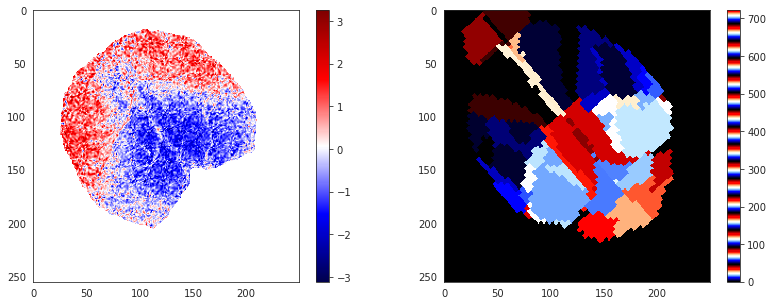

In [10]:
plt.figure(figsize=(13.5, 5))

plt.subplot(121)
plt.imshow(ca[..., 1729], interpolation='antialiased', cmap='seismic')
plt.colorbar()

plt.subplot(122)
plt.imshow(atlas, cmap='flag_r', interpolation='none')
plt.colorbar()

plt.show()

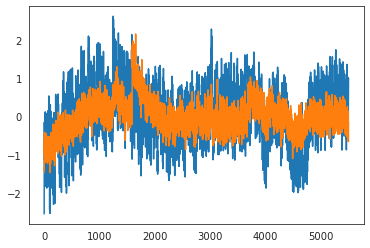

In [13]:
plt.plot(ca[(atlas == 8) & (~np.isnan(ca.mean(-1)))].mean(0))
plt.plot(ca[(atlas == 30) & (~np.isnan(ca.mean(-1)))].mean(0))

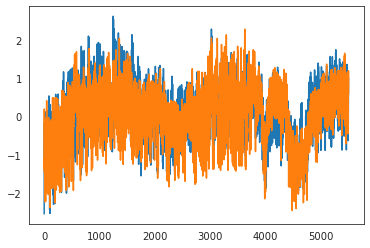

In [14]:
plt.plot(ca[(atlas == 8) & (~np.isnan(ca.mean(-1)))].mean(0))
plt.plot(ca[(atlas == 521) & (~np.isnan(ca.mean(-1)))].mean(0))

In [15]:
sp_stats.pearsonr(
    ca[(atlas == 502) & (~np.isnan(ca.mean(-1)))].mean(0),
    ca[(atlas == 521) & (~np.isnan(ca.mean(-1)))].mean(0)
)

(0.78591171601393, 0.0)

In [16]:
np.unique(atlas)

array([  0.,   2.,   3.,   4.,   5.,   6.,   7.,   8.,   9.,  10.,  11.,
        14.,  15.,  16.,  18.,  19.,  20.,  21.,  22.,  23.,  24.,  25.,
        26.,  28.,  30.,  33.,  38.,  39.,  40.,  41.,  44., 154., 155.,
       156., 160., 215., 216., 221., 501., 502., 503., 504., 505., 506.,
       507., 508., 509., 510., 511., 514., 515., 516., 518., 519., 520.,
       521., 522., 523., 524., 525., 526., 528., 530., 538., 539., 540.,
       541., 544., 655., 656., 715., 716., 721., 722.])

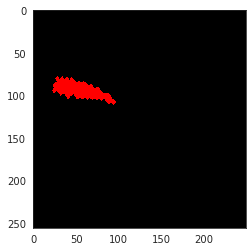

In [17]:
plt.imshow(atlas == 502, cmap='flag_r', interpolation='none')

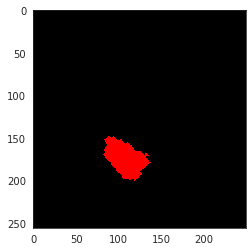

In [18]:
plt.imshow(atlas == 521, cmap='flag_r', interpolation='none')

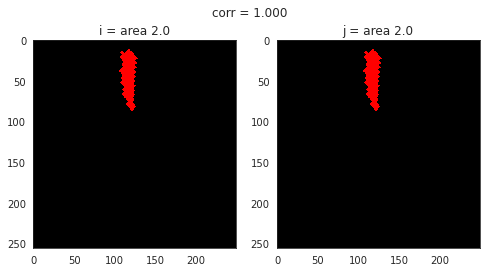

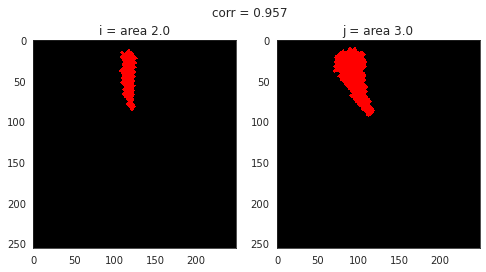

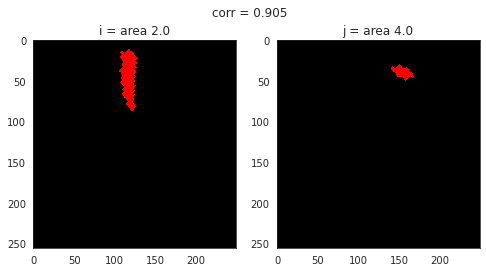

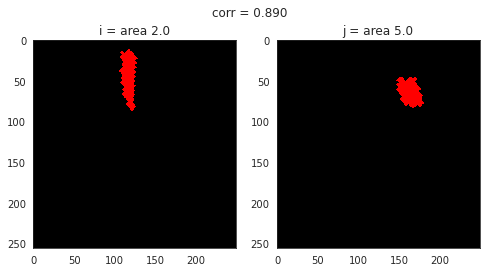

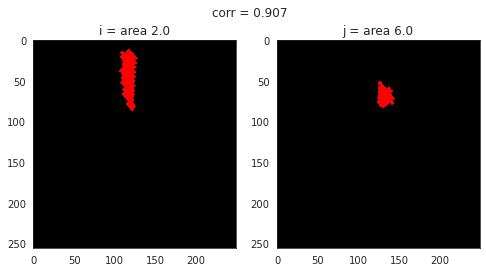

...

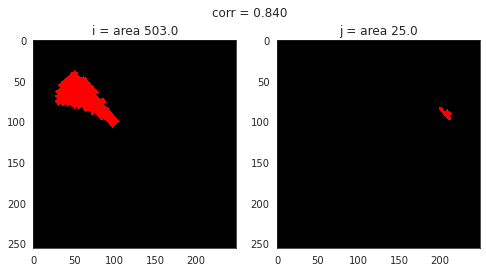

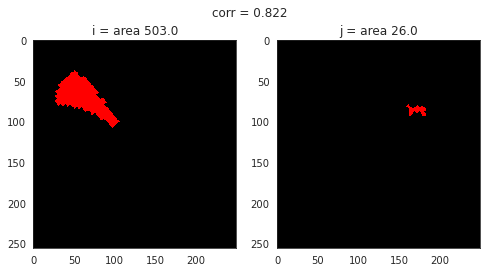

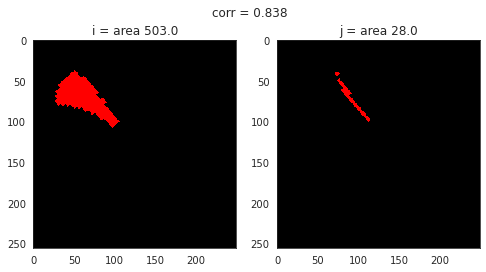

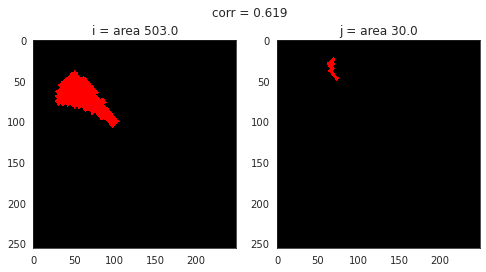

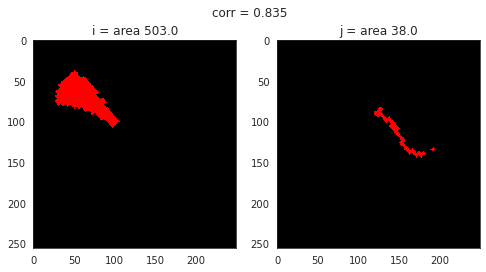

In [302]:
regions = np.unique(atlas)
regions = [x for x in regions if x != 0.]
corrs = np.zeros((len(regions), len(regions)))

for counter_i, i in enumerate(regions):
    for counter_j, j in enumerate(regions):
        
        data_1 = ca[(atlas == i) & (~np.isnan(ca.mean(-1)))].mean(0)
        data_2 = ca[(atlas == j) & (~np.isnan(ca.mean(-1)))].mean(0)
        
        if any(np.isnan(data_1)) or any(np.isnan(data_2)):
            continue
        
        r = sp_stats.pearsonr(data_1, data_2)[0]

      #  plt.figure(figsize=(8, 4))
      #  plt.subplot(121)
      #  plt.imshow(atlas == i, cmap='flag_r', interpolation='none')
      #  plt.title('i = area {}'.format(i))
      #  plt.subplot(122)
      #  plt.imshow(atlas == j, cmap='flag_r', interpolation='none')
      #  plt.title('j = area {}'.format(j))
      #  plt.suptitle('corr = {:.3f}'.format(r))
      #  plt.show()
        
        corrs[counter_i, counter_j] = r
        

In [19]:
regions = np.unique(atlas)
regions = [x for x in regions if x != 0.]
corrs = np.zeros((len(regions), len(regions)))

for counter_i, i in tqdm(enumerate(regions)):
    for counter_j, j in enumerate(regions):
        
        data_1 = ca[(atlas == i) & (~np.isnan(ca.mean(-1)))].mean(0)
        data_2 = ca[(atlas == j) & (~np.isnan(ca.mean(-1)))].mean(0)
        
        if any(np.isnan(data_1)) or any(np.isnan(data_2)):
            continue
        
        r = sp_stats.pearsonr(data_1, data_2)[0]
        corrs[counter_i, counter_j] = r

0it [00:00, ?it/s]

In [20]:
plt.imshow(corrs, cmap='nipy_spectral', interpolation='none')
plt.colorbar()

In [21]:
x = corrs.flatten()
x[x == 0.] = np.nan
x[x == 1.] = np.nan
sns.histplot(x, bins=40, kde=True)

<AxesSubplot:ylabel='Count'>

In [70]:
a = corrs.copy()

np.fill_diagonal(a, 0.)
th = 0.85
a[a < th] = 0.

bad_indxs = np.where(a.sum(0) == 0.)[0]
a = np.delete(np.delete(a, bad_indxs, axis=0), bad_indxs, axis=1)

In [71]:
plt.imshow(a, cmap='nipy_spectral', interpolation='none')
plt.colorbar()

In [72]:
x = a.flatten()
x[x == 0.] = np.nan
x[x == 1.] = np.nan
sns.histplot(x, bins=40, kde=True)

<AxesSubplot:ylabel='Count'>

In [73]:
g = nx.from_numpy_array(a)

In [74]:
nx.draw(g)

In [75]:
import netrd

In [76]:
import percolate

In [86]:
perc = percolate.sample_states(g, spanning_cluster=False)

In [87]:
next(perc)

{'n': 0,
 'N': 58,
 'M': 428,
 'max_cluster_size': 1,
 'moments': array([57., 57., 57., 57., 57.])}

In [188]:
results = run_louvain(g, res=np.logspace(-1, 1, 1000))

  0%|          | 0/1000 [00:00<?, ?it/s]

In [208]:
selected_idxs = [400, 460, 550, 650]

plot_louvain_results(results=results, selected_idxs=selected_idxs)

In [200]:
x0, y0 = zip(*results['modularities'].items())

max_idx = np.argmax(y0)
best_res = x0[max_idx]
max_Q = y0[max_idx]

max_idx, best_res, max_Q

(491, 0.9615746001432098, 0.3321662000245308)

In [201]:
results.keys()

dict_keys(['communities', 'memberships', 'partitions', 'modularities', 'num_communities'])

In [206]:
best_communities = list(results['communities'].values())[max_idx]
best_partition = list(results['partitions'].values())[max_idx]
len(best_communities)

3

In [207]:
best_partition

{0: 1,
 1: 1,
 2: 1,
 3: 1,
 4: 1,
 5: 1,
 6: 1,
 7: 2,
 8: 1,
 9: 1,
 10: 0,
 11: 0,
 12: 0,
 13: 0,
 14: 2,
 15: 0,
 16: 0,
 17: 0,
 18: 2,
 19: 0,
 20: 0,
 21: 1,
 22: 2,
 23: 2,
 24: 2,
 25: 2,
 26: 2,
 27: 0,
 28: 0,
 29: 1,
 30: 1,
 31: 1,
 32: 1,
 33: 1,
 34: 1,
 35: 1,
 36: 2,
 37: 1,
 38: 1,
 39: 0,
 40: 0,
 41: 0,
 42: 0,
 43: 2,
 44: 0,
 45: 0,
 46: 0,
 47: 2,
 48: 2,
 49: 0,
 50: 0,
 51: 1,
 52: 2,
 53: 2,
 54: 2,
 55: 0,
 56: 2,
 57: 2}

# TODO: load reference image

In [6]:
import warnings
warnings.filterwarnings('ignore', category=RuntimeWarning)

In [7]:
data = load_ca_with_extras()
ca, atlas, ref, mask = data['ca'], data['atlas'], data['ref'], data['mask']

Loading:
sub-SLC01_ses-1_run-1_task-rest_ca.npy

-->  50 s  <-- excluded from the beginning of each run. Combined runs duration:
00 - 00:09:10  (dd - hh:mm:ss)



In [8]:
ca.shape, atlas.shape, ref.shape, mask.shape

((256, 250, 5500), (256, 250), (256, 250), (256, 250))

In [9]:
ca.dtype, atlas.dtype, ref.dtype, mask.dtype

(dtype('float64'), dtype('int64'), dtype('float64'), dtype('bool'))

In [10]:
plt.figure(figsize=(13.5, 3.5))


plt.subplot(131)
plt.imshow(ref, cmap='nipy_spectral', interpolation='none')
plt.colorbar()

plt.subplot(132)
plt.imshow(atlas, cmap='flag_r', interpolation='none')
plt.colorbar()

plt.subplot(133)
plt.imshow(mask, cmap='nipy_spectral', interpolation='none')
plt.colorbar()

plt.tight_layout()
plt.show()

In [11]:
np.unique(atlas), len(np.unique(atlas))

(array([  0,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  14,  15,
         16,  18,  19,  20,  21,  22,  23,  24,  25,  26,  27,  28,  30,
         38,  39,  40,  41, 154, 155, 156, 221, 222, 502, 503, 504, 505,
        506, 507, 508, 509, 510, 511, 514, 515, 516, 518, 519, 520, 521,
        522, 523, 524, 525, 526, 527, 528, 530, 538, 539, 540, 541, 568,
        655, 656, 721, 722]),
 69)

In [239]:
from importlib import reload
from model import configuration
reload(configuration)

from model.configuration import Config

In [240]:
from importlib import reload
from utils import processing
reload(processing)

from utils.processing import organize_ca_data

In [227]:
from importlib import reload
from utils import processing
reload(processing)

from utils.processing import filter_boundaries

In [12]:
ca, atlas, ref, mask = filter_boundaries(
    x_list=[ca, atlas, ref, mask],
    mask=mask,
    dim=2,
)

In [13]:
ca.shape, atlas.shape, ref.shape, mask.shape

((193, 188, 5500), (193, 188), (193, 188), (193, 188))

In [16]:
plt.figure(figsize=(13.5, 3.5))


plt.subplot(131)
plt.imshow(ref, cmap='Greys_r', interpolation='none')
plt.title('Reference img', fontsize=15)
plt.colorbar()

plt.subplot(132)
plt.imshow(atlas, cmap='flag_r', interpolation='none')
plt.title('Atlas', fontsize=15)
plt.colorbar()

plt.subplot(133)
plt.imshow(mask, cmap='Greys_r', interpolation='none')
plt.title('Mask', fontsize=15)
plt.colorbar()

plt.tight_layout()
plt.savefig('atlas.png', dpi=200)
plt.show()

In [33]:
np.unique(atlas), len(np.unique(atlas))

(array([  0,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  14,  15,
         16,  18,  19,  20,  21,  22,  23,  24,  25,  26,  27,  28,  30,
         38,  39,  40,  41, 154, 155, 156, 221, 222, 502, 503, 504, 505,
        506, 507, 508, 509, 510, 511, 514, 515, 516, 518, 519, 520, 521,
        522, 523, 524, 525, 526, 527, 528, 530, 538, 539, 540, 541, 568,
        655, 656, 721, 722]),
 69)

### Task: verify scipy butter implementation

In [133]:
import numpy as np
import matplotlib.pyplot as plt

fs = 10
t = np.arange(6000) / fs

f_a = 0.1
f_b = 2

signala = np.sin(2*np.pi*f_a*t)
signalb = np.sin(2*np.pi*f_b*t)
signalc = signala + signalb


low = 0.001
high = 1.0

order = 2

output = apply_bandpass(signalc, fs=fs, lowcut=low, highcut=high, order=order)

  0%|          | 0/1 [00:00<?, ?it/s]

In [134]:
plt.figure(figsize=(14, 5))

plt.plot(signala[:200], label='a (f_a = {:.1f} Hz)'.format(f_a))
plt.plot(signalb[:200], label='b (f_b = {:.1f} Hz)'.format(f_b))
plt.plot(signalc[:200], label='c = a + b')
plt.plot(output[:200], label='filtered (band: [{:.3f}, {:.3f}] Hz)'.format(low, high), lw=2.5)

plt.legend()
plt.show()

### Now take ca, calculate average, and put that in the data Dict[int, np.ndarray]
- The key is label integer, and value is average of all pixels that belong to that region
- Visualize dynamics by populating each pixel defined in atlas by this noise cancelled average

In [224]:
from importlib import reload
from model import configuration
reload(configuration)

from model.configuration import Config

In [225]:
from importlib import reload
from utils import processing
reload(processing)

from utils.processing import load_ca_with_extras

In [226]:
config = Config()

In [192]:
def _organize(
        config: Config,
        subject: int,
        session: int,
        run: int,
        lowcut: float,
        highcut: float,
        bandpass_order: int,
        bandpass_mode: str,
        normalize: bool = True,
        verbose: bool = False, ):
    
    data = load_ca_with_extras(
        config=config,
        subject=subject,
        session=session,
        run=run,
        normalize=normalize,
        verbose=verbose,
    )

    region_ids = np.unique(data['atlas'])
    region_ids = [item for item in region_ids if item != 0]
    
    ca_organized = {}
    for key in region_ids:
        x = data['ca'][data['atlas'] == key]
        #x = data['ca'][(data['atlas'] == key) & (~np.isnan(data['ca'].mean(-1)))]
        if bandpass_mode == 'before':
            x_bp = apply_bandpass(
                x=x,
                fs=config.ca_fs,
                lowcut=lowcut,
                highcut=highcut,
                order=bandpass_order,
            ).mean(0)
        elif bandpass_mode == 'after':
            x_bp = apply_bandpass(
                x=x.mean(0),
                fs=config.ca_fs,
                lowcut=lowcut,
                highcut=highcut,
                order=bandpass_order,
            )
        elif bandpass_mode == 'none':
            x_bp = x.mean(0)
        else:
            raise ValueError('invalid bandpass mode: {:s}'.format(bandpass_mode))
        
        ca_organized[key] = x_bp

    return ca_organized

In [216]:
ca_organized_none = _organize(
        config=config,
        subject=1,
        session=1,
        run=1,
        lowcut=0.001,
        highcut=4.0,
        bandpass_order=2,
        bandpass_mode='none',
)
ca_organized_before = _organize(
        config=config,
        subject=1,
        session=1,
        run=1,
        lowcut=0.001,
        highcut=1.0,
        bandpass_order=2,
        bandpass_mode='before',
)
ca_organized_after = _organize(
        config=config,
        subject=1,
        session=1,
        run=1,
        lowcut=0.001,
        highcut=1.0,
        bandpass_order=2,
        bandpass_mode='after',
)

  0%|          | 0/1113 [00:00<?, ?it/s]

  0%|          | 0/1630 [00:00<?, ?it/s]

  0%|          | 0/316 [00:00<?, ?it/s]

  0%|          | 0/877 [00:00<?, ?it/s]

  0%|          | 0/412 [00:00<?, ?it/s]

  0%|          | 0/319 [00:00<?, ?it/s]

  0%|          | 0/487 [00:00<?, ?it/s]

  0%|          | 0/289 [00:00<?, ?it/s]

  0%|          | 0/140 [00:00<?, ?it/s]

  0%|          | 0/268 [00:00<?, ?it/s]

  0%|          | 0/123 [00:00<?, ?it/s]

  0%|          | 0/124 [00:00<?, ?it/s]

  0%|          | 0/52 [00:00<?, ?it/s]

  0%|          | 0/126 [00:00<?, ?it/s]

  0%|          | 0/187 [00:00<?, ?it/s]

  0%|          | 0/238 [00:00<?, ?it/s]

  0%|          | 0/1362 [00:00<?, ?it/s]

  0%|          | 0/75 [00:00<?, ?it/s]

  0%|          | 0/268 [00:00<?, ?it/s]

  0%|          | 0/313 [00:00<?, ?it/s]

  0%|          | 0/61 [00:00<?, ?it/s]

  0%|          | 0/177 [00:00<?, ?it/s]

  0%|          | 0/81 [00:00<?, ?it/s]

  0%|          | 0/223 [00:00<?, ?it/s]

  0%|          | 0/23 [00:00<?, ?it/s]

  0%|          | 0/471 [00:00<?, ?it/s]

  0%|          | 0/905 [00:00<?, ?it/s]

  0%|          | 0/171 [00:00<?, ?it/s]

  0%|          | 0/88 [00:00<?, ?it/s]

  0%|          | 0/9 [00:00<?, ?it/s]

  0%|          | 0/191 [00:00<?, ?it/s]

  0%|          | 0/168 [00:00<?, ?it/s]

  0%|          | 0/119 [00:00<?, ?it/s]

  0%|          | 0/17 [00:00<?, ?it/s]

  0%|          | 0/1070 [00:00<?, ?it/s]

  0%|          | 0/1478 [00:00<?, ?it/s]

  0%|          | 0/286 [00:00<?, ?it/s]

  0%|          | 0/956 [00:00<?, ?it/s]

  0%|          | 0/424 [00:00<?, ?it/s]

  0%|          | 0/420 [00:00<?, ?it/s]

  0%|          | 0/466 [00:00<?, ?it/s]

  0%|          | 0/281 [00:00<?, ?it/s]

  0%|          | 0/157 [00:00<?, ?it/s]

  0%|          | 0/520 [00:00<?, ?it/s]

  0%|          | 0/222 [00:00<?, ?it/s]

  0%|          | 0/205 [00:00<?, ?it/s]

  0%|          | 0/94 [00:00<?, ?it/s]

  0%|          | 0/123 [00:00<?, ?it/s]

  0%|          | 0/216 [00:00<?, ?it/s]

  0%|          | 0/244 [00:00<?, ?it/s]

  0%|          | 0/1316 [00:00<?, ?it/s]

  0%|          | 0/61 [00:00<?, ?it/s]

  0%|          | 0/284 [00:00<?, ?it/s]

  0%|          | 0/299 [00:00<?, ?it/s]

  0%|          | 0/96 [00:00<?, ?it/s]

  0%|          | 0/213 [00:00<?, ?it/s]

  0%|          | 0/109 [00:00<?, ?it/s]

  0%|          | 0/219 [00:00<?, ?it/s]

  0%|          | 0/12 [00:00<?, ?it/s]

  0%|          | 0/379 [00:00<?, ?it/s]

  0%|          | 0/809 [00:00<?, ?it/s]

  0%|          | 0/252 [00:00<?, ?it/s]

  0%|          | 0/96 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/183 [00:00<?, ?it/s]

  0%|          | 0/156 [00:00<?, ?it/s]

  0%|          | 0/142 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/1 [00:00<?, ?it/s]

In [167]:
ca, atlas, ref, mask = data['ca'], data['atlas'], data['ref'], data['mask']

In [168]:
ca.shape, atlas.shape, ref.shape, mask.shape

((256, 250, 5500), (256, 250), (256, 250), (256, 250))

In [169]:
ca.dtype, atlas.dtype, ref.dtype, mask.dtype

(dtype('float64'), dtype('int64'), dtype('float64'), dtype('bool'))

In [170]:
plt.figure(figsize=(13.5, 3.5))


plt.subplot(131)
plt.imshow(ref, cmap='nipy_spectral', interpolation='none')
plt.colorbar()

plt.subplot(132)
plt.imshow(atlas, cmap='flag_r', interpolation='none')
plt.colorbar()

plt.subplot(133)
plt.imshow(mask, cmap='nipy_spectral', interpolation='none')
plt.colorbar()

plt.tight_layout()
plt.show()

In [171]:
np.unique(atlas), len(np.unique(atlas))

(array([  0,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  14,  15,
         16,  18,  19,  20,  21,  22,  23,  24,  25,  26,  27,  28,  30,
         38,  39,  40,  41, 154, 155, 156, 221, 222, 502, 503, 504, 505,
        506, 507, 508, 509, 510, 511, 514, 515, 516, 518, 519, 520, 521,
        522, 523, 524, 525, 526, 527, 528, 530, 538, 539, 540, 541, 568,
        655, 656, 721, 722]),
 69)

In [220]:
config.processed_dir

'/home/hadi/Documents/Ca-fMRI/processed'

In [ ]:
ca, atlas, ref, mask = filter_boundaries(
    x_list=[ca, atlas, ref, mask],
    mask=mask,
    dim=2,
)

In [ ]:
ca.shape, atlas.shape, ref.shape, mask.shape

In [ ]:
plt.figure(figsize=(13.5, 3.5))


plt.subplot(131)
plt.imshow(ref, cmap='Greys_r', interpolation='none')
plt.title('Reference img', fontsize=15)

plt.subplot(132)
plt.imshow(atlas, cmap='flag_r', interpolation='none')
plt.title('Atlas', fontsize=15)
plt.colorbar()

plt.subplot(133)
plt.imshow(mask, cmap='Greys_r', interpolation='none')
plt.title('Mask', fontsize=15)

plt.tight_layout()
plt.show()

In [172]:
ca_organized.keys()

dict_keys([2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 14, 15, 16, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 30, 38, 39, 40, 41, 154, 155, 156, 221, 222, 502, 503, 504, 505, 506, 507, 508, 509, 510, 511, 514, 515, 516, 518, 519, 520, 521, 522, 523, 524, 525, 526, 527, 528, 530, 538, 539, 540, 541, 568, 655, 656, 721, 722])

In [173]:
len(ca_organized)

68

In [175]:
np.unique(data['atlas'])

array([  0,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  14,  15,
        16,  18,  19,  20,  21,  22,  23,  24,  25,  26,  27,  28,  30,
        38,  39,  40,  41, 154, 155, 156, 221, 222, 502, 503, 504, 505,
       506, 507, 508, 509, 510, 511, 514, 515, 516, 518, 519, 520, 521,
       522, 523, 524, 525, 526, 527, 528, 530, 538, 539, 540, 541, 568,
       655, 656, 721, 722])

In [194]:
plt.figure(figsize=(20, 4))
plt.plot(ca_organized[526][:2000])
plt.plot(ca_organized[540][:2000])

In [183]:
plt.plot(ca_organized[526])
plt.plot(ca_organized[540])

In [195]:
ca, atlas, ref, mask = data['ca'], data['atlas'], data['ref'], data['mask']

In [196]:
ca.shape

(256, 250, 5500)

In [206]:
test = []

a, b = np.where(data['atlas'] == 540)
for i, j in zip(list(a), list(b)):
    test.append(data['ca'][i, j].reshape(1, -1))
    
test = np.concatenate(test)
test.shape

(252, 5500)

In [213]:
plt.figure(figsize=(20, 10))
plt.imshow(test, aspect=10)

In [214]:
plt.plot(test.mean(0))

In [215]:
plt.figure(figsize=(20, 4))
plt.plot(test.mean(0)[:2000])

### Before, after, none

In [217]:
plt.figure(figsize=(20, 4))
plt.plot(ca_organized_before[526][:3000])
plt.plot(ca_organized_before[540][:3000])

In [218]:
plt.figure(figsize=(20, 4))
plt.plot(ca_organized_after[526][:3000])
plt.plot(ca_organized_after[540][:3000])

In [219]:
plt.figure(figsize=(20, 4))
plt.plot(ca_organized_none[526][:3000])
plt.plot(ca_organized_none[540][:3000])